<a href="https://colab.research.google.com/github/yamihe19/Project-CNN-Keras-ImageClassification-NLP-TextClassification/blob/main/Code_Project_CNN%2BKeras_ImageClassification_NLP_TextClassification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Project CNN+Keras Image Classification and Text Classification using NLP

This file contains  2 projects:

1. Image classification for the CIFAR-100 dataset using CNN+KERAS. [Click here to go to the dataset](https://www.cs.toronto.edu/~kriz/cifar.html).
2. Text classification for sentiment analysis on the tweet data about COVID19 using TF-IDF and Gensim.

# Project 1
### The relevant Dataset (CIFAR 100) have been described below.




This is a dataset of 50,000 32x32 color training images and 10,000 test images, labeled over 100 fine-grained classes that are grouped into 20 coarse-grained classes.

- Images have low resolution (32x32).

- Data Source: https://www.cs.toronto.edu/~kriz/cifar.html

Read the website thoroughly.

The dataset can be directly fetched from Keras.io Website for easy incorporation into your code.
https://keras.io/api/datasets/cifar100/


### CIFAR-100 Image label detection of provided images

Prepare a model from the CIFAR-100 dataset using CNN+KERAS. Use 2 Convolution Layers and subsamplings before creating the Neural Model. Choose 512 neurons in the 1st layer and a dropout of 25% in the 2nd hidden layer before using 'SOFTMAX' activation function at the end to obtain the labels. Use 'RELU' in the internal layers as activation function. Use RMSProp as the optimizer and CROSS-Entropy as the loss function. Use 'Accuracy' as the metrics. [7.5 Marks]

Download the 4 images provided on D2L. These images are of television,camel,wardrobe, and truck. Create a validation dataset using these images and predict the labels using the model of CIFAR-100 created by you as above. [7.5 Marks]

## Importing libraries

In [ ]:
import tensorflow
from tensorflow import keras
from tensorflow.keras.datasets import mnist
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Conv2D , MaxPooling2D, Flatten#animation(Conv2D)
from tensorflow.keras.optimizers import RMSprop#the  best optimizer even for animation

## Loading data

In [ ]:
(x_train, y_train), (x_test, y_test) = keras.datasets.cifar100.load_data() # Training and testing

In [ ]:

assert x_train.shape == (50000, 32, 32, 3)
assert x_test.shape == (10000, 32, 32, 3)
assert y_train.shape == (50000, 1)
assert y_test.shape == (10000, 1)

In [ ]:
x_train[0]

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [195, 205, 193],
        [212, 224, 204],
        [182, 194, 167]],

       [[255, 255, 255],
        [254, 254, 254],
        [254, 254, 254],
        ...,
        [170, 176, 150],
        [161, 168, 130],
        [146, 154, 113]],

       [[255, 255, 255],
        [254, 254, 254],
        [255, 255, 255],
        ...,
        [189, 199, 169],
        [166, 178, 130],
        [121, 133,  87]],

       ...,

       [[148, 185,  79],
        [142, 182,  57],
        [140, 179,  60],
        ...,
        [ 30,  17,   1],
        [ 65,  62,  15],
        [ 76,  77,  20]],

       [[122, 157,  66],
        [120, 155,  58],
        [126, 160,  71],
        ...,
        [ 22,  16,   3],
        [ 97, 112,  56],
        [141, 161,  87]],

       [[ 87, 122,  41],
        [ 88, 122,  39],
        [101, 134,  56],
        ...,
        [ 34,  36,  10],
        [105, 133,  59],
        [138, 173,  79]]

In [ ]:
x_test[0]

array([[[199, 215, 249],
        [196, 211, 244],
        [195, 210, 243],
        ...,
        [216, 231, 250],
        [217, 231, 250],
        [224, 234, 252]],

       [[197, 210, 239],
        [195, 208, 238],
        [195, 210, 240],
        ...,
        [231, 243, 250],
        [233, 243, 250],
        [241, 245, 253]],

       [[222, 226, 246],
        [213, 220, 242],
        [209, 219, 243],
        ...,
        [243, 250, 251],
        [244, 249, 251],
        [250, 250, 253]],

       ...,

       [[ 72,  73,  99],
        [ 71,  74, 102],
        [ 74,  78, 108],
        ...,
        [220, 208, 217],
        [183, 168, 181],
        [155, 141, 150]],

       [[ 72,  75, 104],
        [ 76,  81, 111],
        [ 84,  89, 122],
        ...,
        [222, 212, 220],
        [187, 174, 192],
        [145, 132, 149]],

       [[ 80,  85, 118],
        [ 84,  90, 123],
        [ 85,  92, 127],
        ...,
        [217, 207, 215],
        [207, 194, 211],
        [176, 164, 183]]

In [ ]:
y_train[0:10]

array([[19],
       [29],
       [ 0],
       [11],
       [ 1],
       [86],
       [90],
       [28],
       [23],
       [31]])

In [ ]:
y_test[0:40]

array([[49],
       [33],
       [72],
       [51],
       [71],
       [92],
       [15],
       [14],
       [23],
       [ 0],
       [71],
       [75],
       [81],
       [69],
       [40],
       [43],
       [92],
       [97],
       [70],
       [53],
       [70],
       [49],
       [75],
       [29],
       [21],
       [16],
       [39],
       [ 8],
       [ 8],
       [70],
       [20],
       [61],
       [41],
       [93],
       [56],
       [73],
       [58],
       [11],
       [25],
       [37]])

In [ ]:
train_images = x_train.astype('float32')
test_images = x_test.astype('float32')
train_images /= 3072 # because the values range form 0 to 255
test_images /= 3072 # To normalize

In [ ]:
type(train_images[0])

numpy.ndarray

In [ ]:
train_labels = keras.utils.to_categorical(y_train, 100)
test_labels = keras.utils.to_categorical(y_test, 100)# one hot enconding

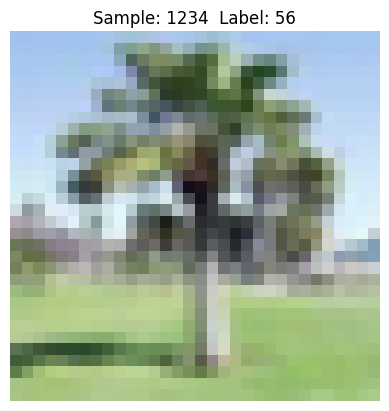

In [ ]:
import numpy as np

def display_sample(x, y, num):
    # Extract the image and label for the given sample number
    image = x[num]
    label = y[num]

    # Plot the image
    plt.imshow(image)
    plt.title('Sample: %d  Label: %d' % (num, label))
    plt.axis('off')  # Turn off axis ticks and labels
    plt.show()

# Assuming you have the following data:
# x_train: Training images with shape (50000, 32, 32, 3)
# x_test: Test images with shape (10000, 32, 32, 3)
# y_train: Training labels with shape (50000, 1)
# y_test: Test labels with shape (10000, 1)

# Display a sample image from the training data
sample_num = 1234  # Change this number to display a different sample
display_sample(x_train, y_train, sample_num)

In [ ]:

# Define the CNN model
model = Sequential()

# 1st Convolutional Layer
model.add(Conv2D(81, kernel_size=(3, 3), activation='relu', input_shape=(32, 32, 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))

# 2nd Convolutional Layer
model.add(Conv2D(128, kernel_size=(3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())

# 1st Hidden Layer with 512 neurons
model.add(Dense(512, activation='relu'))

# 2nd Hidden Layer with 256 neurons
model.add(Dense(256, activation='relu'))  # 100 classes in CIFAR-100
model.add(Dropout(0.25))

# Output Laye. Final categorization from 0 to 99 with softmax
model.add(Dense(100, activation='softmax'))

In [ ]:
model.summary()

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_20 (Conv2D)          (None, 30, 30, 81)        2268      
                                                                 
 max_pooling2d_18 (MaxPoolin  (None, 15, 15, 81)       0         
 g2D)                                                            
                                                                 
 conv2d_21 (Conv2D)          (None, 13, 13, 128)       93440     
                                                                 
 max_pooling2d_19 (MaxPoolin  (None, 6, 6, 128)        0         
 g2D)                                                            
                                                                 
 flatten_10 (Flatten)        (None, 4608)              0         
                                                                 
 dense_28 (Dense)            (None, 512)             

In [ ]:
# Compile the model
model.compile(optimizer= RMSprop(), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
history = model.fit(train_images, train_labels,
                    batch_size=5,
                    epochs=10,
                    verbose=2
                    )#

Epoch 1/10
10000/10000 - 36s - loss: 4.1416 - accuracy: 0.0622 - 36s/epoch - 4ms/step
Epoch 2/10
10000/10000 - 31s - loss: 3.7614 - accuracy: 0.1273 - 31s/epoch - 3ms/step
Epoch 3/10
10000/10000 - 30s - loss: 3.6320 - accuracy: 0.1539 - 30s/epoch - 3ms/step
Epoch 4/10
10000/10000 - 31s - loss: 3.6138 - accuracy: 0.1588 - 31s/epoch - 3ms/step
Epoch 5/10
10000/10000 - 31s - loss: 3.6367 - accuracy: 0.1586 - 31s/epoch - 3ms/step
Epoch 6/10
10000/10000 - 31s - loss: 3.6417 - accuracy: 0.1632 - 31s/epoch - 3ms/step
Epoch 7/10
10000/10000 - 31s - loss: 3.6439 - accuracy: 0.1646 - 31s/epoch - 3ms/step
Epoch 8/10
10000/10000 - 31s - loss: 3.6462 - accuracy: 0.1649 - 31s/epoch - 3ms/step
Epoch 9/10
10000/10000 - 32s - loss: 3.6515 - accuracy: 0.1684 - 32s/epoch - 3ms/step
Epoch 10/10
10000/10000 - 30s - loss: 3.6649 - accuracy: 0.1653 - 30s/epoch - 3ms/step


In [ ]:
import cv2
import numpy as np

# Loading and preprocess the provided images for validation
tv_img = cv2.imread("television.jpg")
camel_img = cv2.imread("camel.jpg")
wardrobe_img = cv2.imread("wardrobe.jpg")
truck_img = cv2.imread("truck.jpg")

# Resizing images to the same size as CIFAR-100 images (32x32)
tv_img = cv2.resize(tv_img, (32, 32))
camel_img = cv2.resize(camel_img, (32, 32))
wardrobe_img = cv2.resize(wardrobe_img, (32, 32))
truck_img = cv2.resize(truck_img, (32, 32))



In [ ]:
tv_img.shape # Still three dimentions

(32, 32, 3)

In [ ]:
# Converting images to float32 and normalize pixel values (0-255) to (0-1)
tv_img = tv_img.astype('float32') / 255
camel_img = camel_img.astype('float32') / 255
wardrobe_img = wardrobe_img.astype('float32') / 255
truck_img = truck_img.astype('float32') / 255

# Expanding dimensions to match the input shape of the model
tv_img = np.expand_dims(tv_img, axis=0)
camel_img = np.expand_dims(camel_img, axis=0)
wardrobe_img = np.expand_dims(wardrobe_img, axis=0)
truck_img = np.expand_dims(truck_img, axis=0)



In [ ]:
tv_img.shape# Forth dimention because it is a color image

(1, 32, 32, 3)

In [ ]:
# Predicting labels using the trained model
tv_label = np.argmax(model.predict(tv_img), axis=-1)
camel_label = np.argmax(model.predict(camel_img), axis=-1)
wardrobe_label = np.argmax(model.predict(wardrobe_img), axis=-1)
truck_label = np.argmax(model.predict(truck_img), axis=-1)

# Print the predicted labels
print("Predicted TV Label:", tv_label)
print("Predicted Camel Label:", camel_label)
print("Predicted Wardrobe Label:", wardrobe_label)
print("Predicted Truck Label:", truck_label)

1/1 [==============================] - 0s 17ms/step
Predicted TV Label: [62]
Predicted Camel Label: [20]
Predicted Wardrobe Label: [58]
Predicted Truck Label: [20]


The accuracy is not good for this model we should look differents ways to improve like changing the hyper parameters or adding more layers.

## Prepare a model from the CIFAR-100 dataset using CNN+KERAS. Use 2 Convolution Layers and subsamplings before creating the Neural Model. Choose 512 neurons in the 1st layer and a dropout of 25% in the 2nd hidden layer before using 'SOFTMAX' activation function at the end to obtain the labels. Use 'RELU' in the internal layers as activation function. Use RMSProp as the optimizer and CROSS-Entropy as the loss function. Use 'Accuracy' as the metrics. [7.5 Marks]

## Download the 4 images provided on D2L. These images are of television,camel,wardrobe, and truck. Create a validation dataset using these images and predict the labels using the model of CIFAR-100 created by you as above. [7.5 Marks]

## Project 2

## Perform Text Classification on the tweet data about COVID19. The tweets have been pulled from Twitter and manual tagging has been done on them.

## A sample .ipynb work file for this problem have been provided with spam.csv file (File used in Class work with GenSim).

## Few things are missing in the code that you need to apply to complete it.

### 1. Use the original Tweet File instead of the sample spam.csv used in class for your problem 2's analysis. [2 Marks]
### 2. Properly remove punctuations, stopwords and any words of length 1 or 2. [3 Marks]
### 3. Get the wordcloud (as mentioned in the code) after applying step 1 and step 2 (This has not been done in the code). [2 Marks]
### 4. Change number of Topics to 20 in the Gensim LDAMulticore and draw the visualisation as shown in samplecode. Also figure out, about how many topic clusters could be ideal for such application.[3 Marks]
### 5. Write a complete code using TF-IDF along with Random Forest Classifier to build a Tweet Sentiment classification Model.Use your own discretion to determine the relevant hyperparameters and model parameters. Make sure to provide justification while dropping a column. Remember this is a multiclass classification problem. Give the relevant precision and recall for the model.[5 Marks]


## Columns:
## 1) Location
## 2) Tweet At
## 3) Original Tweet
## 4) Sentiment (To be predicted)

## 1. Use the original Tweet File instead of the sample spam.csv used in class for your problem 2's analysis. [2 Marks]

In [ ]:
import nltk
nltk.download('stopwords')

import gensim
from gensim import corpora, models

from pprint import pprint

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
!pip install pyLDAvis

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 18.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.6/17.6 MB 45.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 51.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 341.8/341.8 kB 41.8 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.22.4
    Uninstalling numpy-1.22.4:
      Successfully uninstalled numpy-1.22.4
  Attempting uninstall: pandas
    Found existing installation: pandas 1.5.3
    Uninstalling pandas-1.5.3:
      Successfully uninstalled pandas-1.5.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires pandas==1.5.3, but you have pandas 2.0.3 which is incompatible.
numba 0.56.4 requires numpy<1.24,>=1.18, but you have numpy 1.25.1 which is incompatible.
tensorflow 2.12.0 

In [ ]:
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
import matplotlib.pyplot as plt
%matplotlib inline

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import pandas as pd

stopwords = nltk.corpus.stopwords.words('english')
tweet = pd.read_csv('Tweets_Corona_NLP.csv', encoding='ISO-8859-1')


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
tweet.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,UserName,ScreenName,Location,TweetAt,OriginalTweet,Sentiment
0,3799,48751,London,16-03-2020,@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...,Neutral
1,3800,48752,UK,16-03-2020,advice Talk to your neighbours family to excha...,Positive
2,3801,48753,Vagabonds,16-03-2020,Coronavirus Australia: Woolworths to give elde...,Positive
3,3802,48754,NaN,16-03-2020,My food stock is not the only one which is emp...,Positive
4,3803,48755,NaN,16-03-2020,"Me, ready to go at supermarket during the #COV...",Extremely Negative


In [ ]:
tweet.columns

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Index(['UserName', 'ScreenName', 'Location', 'TweetAt', 'OriginalTweet',
       'Sentiment'],
      dtype='object')

I will not use the columns 'UserName', 'ScreenName', 'Location', 'TweetAt'. Just Sentiment and Original Tweet for the NLP topic modeling and the Sentiment for the Sentiment analysis

In [ ]:
df = tweet.drop(labels = ['UserName', 'ScreenName', 'Location', 'TweetAt',], axis = 1)



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
df.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,OriginalTweet,Sentiment
0,@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...,Neutral
1,advice Talk to your neighbours family to excha...,Positive
2,Coronavirus Australia: Woolworths to give elde...,Positive
3,My food stock is not the only one which is emp...,Positive
4,"Me, ready to go at supermarket during the #COV...",Extremely Negative


In [ ]:
df['OriginalTweet']

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


0        @MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...
1        advice Talk to your neighbours family to excha...
2        Coronavirus Australia: Woolworths to give elde...
3        My food stock is not the only one which is emp...
4        Me, ready to go at supermarket during the #COV...
                               ...                        
41152    Airline pilots offering to stock supermarket s...
41153    Response to complaint not provided citing COVI...
41154    You know itÂs getting tough when @KameronWild...
41155    Is it wrong that the smell of hand sanitizer i...
41156    @TartiiCat Well new/used Rift S are going for ...
Name: OriginalTweet, Length: 41157, dtype: object

In [ ]:
## 2. Properly remove punctuations, stopwords and any words of length 1 or 2. [3 Marks]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Removing putuation and stopwords

from string import punctuation
document = df['OriginalTweet'].tolist()

document

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


['@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/iFz9FAn2Pa and https://t.co/xX6ghGFzCC and https://t.co/I2NlzdxNo8',
 'advice Talk to your neighbours family to exchange phone numbers create contact list with phone numbers of neighbours schools employer chemist GP set up online shopping accounts if poss adequate supplies of regular meds but not over order',
 'Coronavirus Australia: Woolworths to give elderly, disabled dedicated shopping hours amid COVID-19 outbreak https://t.co/bInCA9Vp8P',
 "My food stock is not the only one which is empty...\r\r\n\r\r\nPLEASE, don't panic, THERE WILL BE ENOUGH FOOD FOR EVERYONE if you do not take more than you need. \r\r\nStay calm, stay safe.\r\r\n\r\r\n#COVID19france #COVID_19 #COVID19 #coronavirus #confinement #Confinementotal #ConfinementGeneral https://t.co/zrlG0Z520j",
 "Me, ready to go at supermarket during the #COVID19 outbreak.\r\r\n\r\r\nNot because I'm paranoid, but because my food stock is litteraly empty. The #coronavirus is a serious thin

In [ ]:

#Remove puntuations

without_punct = [
    [word for word in doc.lower().split() if word not in punctuation]
    for doc in document
]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
without_punct

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[['@menyrbie',
  '@phil_gahan',
  '@chrisitv',
  'https://t.co/ifz9fan2pa',
  'and',
  'https://t.co/xx6ghgfzcc',
  'and',
  'https://t.co/i2nlzdxno8'],
 ['advice',
  'talk',
  'to',
  'your',
  'neighbours',
  'family',
  'to',
  'exchange',
  'phone',
  'numbers',
  'create',
  'contact',
  'list',
  'with',
  'phone',
  'numbers',
  'of',
  'neighbours',
  'schools',
  'employer',
  'chemist',
  'gp',
  'set',
  'up',
  'online',
  'shopping',
  'accounts',
  'if',
  'poss',
  'adequate',
  'supplies',
  'of',
  'regular',
  'meds',
  'but',
  'not',
  'over',
  'order'],
 ['coronavirus',
  'australia:',
  'woolworths',
  'to',
  'give',
  'elderly,',
  'disabled',
  'dedicated',
  'shopping',
  'hours',
  'amid',
  'covid-19',
  'outbreak',
  'https://t.co/binca9vp8p'],
 ['my',
  'food',
  'stock',
  'is',
  'not',
  'the',
  'only',
  'one',
  'which',
  'is',
  'empty...',
  'please,',
  "don't",
  'panic,',
  'there',
  'will',
  'be',
  'enough',
  'food',
  'for',
  'everyone'

In [ ]:
from nltk.corpus import stopwords

# Removes stop words for a list of words
def remove_stop_words(data):
  sw = stopwords.words('english')
  return [word for word in data if word not in sw]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Removing stop words for the list of list
without_sw = [remove_stop_words(words_list) for words_list in without_punct]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
without_punct

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[['@menyrbie',
  '@phil_gahan',
  '@chrisitv',
  'https://t.co/ifz9fan2pa',
  'and',
  'https://t.co/xx6ghgfzcc',
  'and',
  'https://t.co/i2nlzdxno8'],
 ['advice',
  'talk',
  'to',
  'your',
  'neighbours',
  'family',
  'to',
  'exchange',
  'phone',
  'numbers',
  'create',
  'contact',
  'list',
  'with',
  'phone',
  'numbers',
  'of',
  'neighbours',
  'schools',
  'employer',
  'chemist',
  'gp',
  'set',
  'up',
  'online',
  'shopping',
  'accounts',
  'if',
  'poss',
  'adequate',
  'supplies',
  'of',
  'regular',
  'meds',
  'but',
  'not',
  'over',
  'order'],
 ['coronavirus',
  'australia:',
  'woolworths',
  'to',
  'give',
  'elderly,',
  'disabled',
  'dedicated',
  'shopping',
  'hours',
  'amid',
  'covid-19',
  'outbreak',
  'https://t.co/binca9vp8p'],
 ['my',
  'food',
  'stock',
  'is',
  'not',
  'the',
  'only',
  'one',
  'which',
  'is',
  'empty...',
  'please,',
  "don't",
  'panic,',
  'there',
  'will',
  'be',
  'enough',
  'food',
  'for',
  'everyone'

In [ ]:
without_sw

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[['@menyrbie',
  '@phil_gahan',
  '@chrisitv',
  'https://t.co/ifz9fan2pa',
  'https://t.co/xx6ghgfzcc',
  'https://t.co/i2nlzdxno8'],
 ['advice',
  'talk',
  'neighbours',
  'family',
  'exchange',
  'phone',
  'numbers',
  'create',
  'contact',
  'list',
  'phone',
  'numbers',
  'neighbours',
  'schools',
  'employer',
  'chemist',
  'gp',
  'set',
  'online',
  'shopping',
  'accounts',
  'poss',
  'adequate',
  'supplies',
  'regular',
  'meds',
  'order'],
 ['coronavirus',
  'australia:',
  'woolworths',
  'give',
  'elderly,',
  'disabled',
  'dedicated',
  'shopping',
  'hours',
  'amid',
  'covid-19',
  'outbreak',
  'https://t.co/binca9vp8p'],
 ['food',
  'stock',
  'one',
  'empty...',
  'please,',
  'panic,',
  'enough',
  'food',
  'everyone',
  'take',
  'need.',
  'stay',
  'calm,',
  'stay',
  'safe.',
  '#covid19france',
  '#covid_19',
  '#covid19',
  '#coronavirus',
  '#confinement',
  '#confinementotal',
  '#confinementgeneral',
  'https://t.co/zrlg0z520j'],
 ['me,'

In [ ]:

# Create dictionary from the cleaned data that is without_sw
dictionary= corpora.Dictionary(without_sw)
# Create bow of words from the dictionary
corpus=[dictionary.doc2bow(text) for text in without_sw]


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:

# Join as string the list of list to create  a wordCloud
cleanedsent=" "
for t in without_sw:
  cleanedsent= cleanedsent+ " ".join(t)

cleanedsent

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


' @menyrbie @phil_gahan @chrisitv https://t.co/ifz9fan2pa https://t.co/xx6ghgfzcc https://t.co/i2nlzdxno8advice talk neighbours family exchange phone numbers create contact list phone numbers neighbours schools employer chemist gp set online shopping accounts poss adequate supplies regular meds ordercoronavirus australia: woolworths give elderly, disabled dedicated shopping hours amid covid-19 outbreak https://t.co/binca9vp8pfood stock one empty... please, panic, enough food everyone take need. stay calm, stay safe. #covid19france #covid_19 #covid19 #coronavirus #confinement #confinementotal #confinementgeneral https://t.co/zrlg0z520jme, ready go supermarket #covid19 outbreak. i\'m paranoid, food stock litteraly empty. #coronavirus serious thing, please, panic. causes shortage... #coronavirusfrance #restezchezvous #stayathome #confinement https://t.co/usmualq72nnews regionâ\x92s first confirmed covid-19 case came sullivan county last week, people flocked area stores purchase cleaning s

# 3. Get the wordcloud (as mentioned in the code) after applying step 1 and step 2 (This has not been done in the code). [2 Marks]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


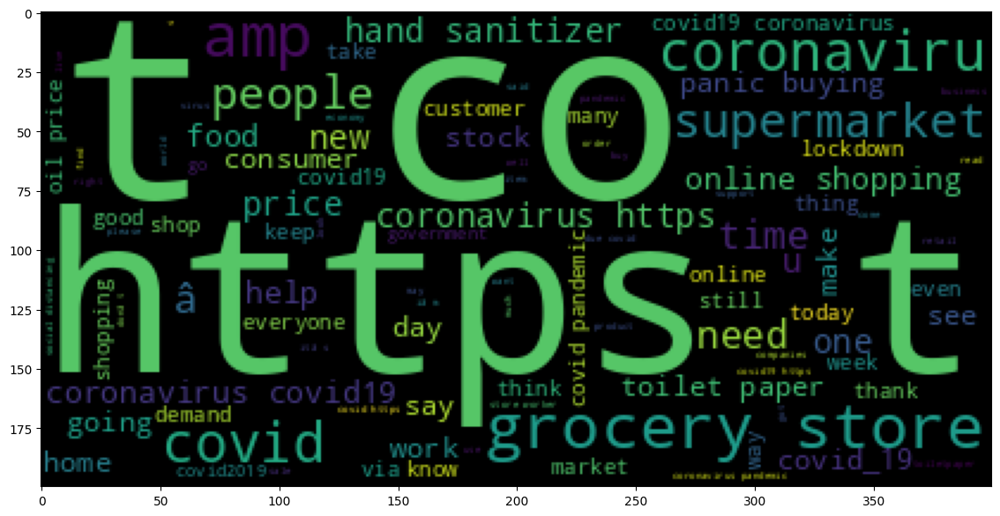

In [ ]:
#word cloud visualization for the text
from wordcloud import WordCloud #visualization techniques for #frequently repeated texts
wc1 = WordCloud(
    background_color='black',
    max_words = 100,
    random_state = 42,
    max_font_size=110
    )

wc1.generate(cleanedsent)
plt.figure(figsize=(30,7))
plt.imshow(wc1)
plt.show()

## 4. Change number of Topics to 20 in the Gensim LDAMulticore and draw the visualisation as shown in samplecode. Also figure out, about how many topic clusters could be ideal for such application.[3 Marks]

In [ ]:
corpus # Print the corpus

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1)],
 [(6, 1),
  (7, 1),
  (8, 1),
  (9, 1),
  (10, 1),
  (11, 1),
  (12, 1),
  (13, 1),
  (14, 1),
  (15, 1),
  (16, 1),
  (17, 1),
  (18, 2),
  (19, 2),
  (20, 1),
  (21, 1),
  (22, 2),
  (23, 1),
  (24, 1),
  (25, 1),
  (26, 1),
  (27, 1),
  (28, 1),
  (29, 1)],
 [(27, 1),
  (30, 1),
  (31, 1),
  (32, 1),
  (33, 1),
  (34, 1),
  (35, 1),
  (36, 1),
  (37, 1),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 1)],
 [(42, 1),
  (43, 1),
  (44, 1),
  (45, 1),
  (46, 1),
  (47, 1),
  (48, 1),
  (49, 1),
  (50, 1),
  (51, 1),
  (52, 1),
  (53, 2),
  (54, 1),
  (55, 1),
  (56, 1),
  (57, 1),
  (58, 1),
  (59, 1),
  (60, 2),
  (61, 1),
  (62, 1)],
 [(42, 1),
  (45, 1),
  (46, 1),
  (53, 1),
  (58, 1),
  (61, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 1),
  (67, 1),
  (68, 1),
  (69, 1),
  (70, 1),
  (71, 1),
  (72, 1),
  (73, 1),
  (74, 1),
  (75, 1),
  (76, 1),
  (77, 1),
  (78, 1),
  (79, 1),
  (80, 1)],
 [(33, 1),
  (81, 1),
  (82, 1),
  (83, 1),
  (

In [ ]:
#Create TFIDF to get better result putting more weights to important words

tfidf = models.TfidfModel(corpus)

corpus_tfidf = tfidf[corpus]
for text in corpus_tfidf:
    print(text)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Streaming output truncated to the last 5000 lines.
[(53, 0.07152243247719338), (186, 0.1508406582936198), (209, 0.17564606593741955), (377, 0.24861602823272014), (378, 0.3656699889604308), (379, 0.22148086183715776), (380, 0.254890718570846), (381, 0.11799231174770518), (382, 0.17973406254468302), (383, 0.20822895301659197), (384, 0.3656699889604308), (385, 0.17089599183975823), (386, 0.13535847813623142), (387, 0.16567657686311102), (388, 0.10279745996884332), (389, 0.17403254316683095), (390, 0.14141184606942295), (391, 0.29410493664452864), (392, 0.3656699889604308), (393, 0.18384580988912647), (394, 0.13635484332225703)]
[(32, 0.08209027649415528), (94, 0.1035223347587791), (139, 0.10973919287357864), (236, 0.060371474158461176), (292, 0.10151779497415402), (293, 0.1155136745066247), (395, 0.13668256235642234), (396, 0.23816619854102902), (397, 0.2739031443200779), (398, 0.20587152611449414), (399, 0.14822661609654833), (400, 0.2739031443200779), (401, 0.2739031443200779), (402, 0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[(45, 0.03127044314564859), (193, 0.12070571268447926), (781, 0.05754215097920238), (984, 0.12187426119141619), (989, 0.15820062698411474), (1108, 0.13340241252840426), (1148, 0.12292433946033399), (1220, 0.15631186465575905), (1491, 0.15898997215286093), (1712, 0.1408258826293186), (2216, 0.10830320603916037), (3739, 0.2295669916213307), (9259, 0.18244582522801583), (10115, 0.20284407219606793), (10556, 0.2619362840209911), (10987, 0.2214228680630615), (23932, 0.21184820596055906), (28093, 0.23385086428166163), (30065, 0.3044278837501314), (30066, 0.3256736836147016), (30067, 0.3256736836147016), (30068, 0.3044278837501314), (30069, 0.2919998875315313)]
[(33, 0.07036541245635947), (45, 0.0354327282933982), (88, 0.13773840715731836), (504, 0.12879789648159928), (1063, 0.13886981246475696), (1518, 0.14621962927451804), (1997, 0.16761411888016617), (21658, 0.3308668389641072), (26178, 0.25329178761977633), (28896, 0.26675930003673387), (30070, 0.30143927631834866), (30071, 0.272727843612

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[(27, 0.11269572630288188), (45, 0.04247980485697448), (79, 0.08294210741938304), (7140, 0.27632061993051077), (10564, 0.2968266505138481), (20561, 0.34257132639656523), (42807, 0.396671648777834), (42808, 0.4424163246605511), (42809, 0.4424163246605511), (42810, 0.3846929704967733)]
[(61, 0.10654917882927105), (90, 0.16329095710023667), (97, 0.07413226946845096), (199, 0.15852690875005912), (565, 0.14838732023447188), (3067, 0.17430453774652385), (3720, 0.19722323243718287), (4915, 0.23401618116262227), (6794, 0.24672543477032785), (7222, 0.21169554495732157), (13361, 0.22482518548887315), (16270, 0.2508314337627765), (21587, 0.24424353023701537), (42811, 0.35584034282518395), (42812, 0.35584034282518395), (42813, 0.35584034282518395), (42814, 0.35584034282518395)]
[(45, 0.03678997635734434), (97, 0.07982340529878755), (114, 0.07085070780012923), (120, 0.074037358926655), (393, 0.19263826439311965), (1032, 0.18477490518246986), (2540, 0.17222312251902847), (42815, 0.3831582131595532),

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[(51, 0.11515879964684007), (95, 0.11601006562994277), (157, 0.11868457971562392), (229, 0.07618309073978376), (236, 0.12441260311491412), (512, 0.07320896443949704), (527, 0.10315306560752513), (890, 0.09169169998171359), (1284, 0.1586081104806344), (2101, 0.1561916969376914), (4680, 0.17578397171340282), (12406, 0.23463455634894256), (15456, 0.2238644977906968), (21143, 0.3874337933819044), (21333, 0.21853423607931244), (29103, 0.26381615162102595), (35864, 0.2454046149071884), (57233, 0.4908092298143768), (57861, 0.2822276883348635), (57862, 0.2822276883348635)]
[(10, 0.1374128612954157), (45, 0.028349770319694906), (79, 0.055353119042987155), (97, 0.061510645844837286), (124, 0.0983499422461982), (187, 0.1278738076874567), (394, 0.11009799885948282), (439, 0.09622424187879844), (470, 0.07597876589130236), (548, 0.19345120076416336), (687, 0.11858152346524814), (694, 0.12256176808478009), (1711, 0.14666819822773797), (2380, 0.1684198074287499), (2763, 0.14693411771069304), (3635, 0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[(45, 0.02693874910777733), (56, 0.08433453980006175), (79, 0.052598090545941674), (120, 0.05421242507347964), (470, 0.07219716028677763), (473, 0.12491675342343876), (490, 0.10421660589364265), (591, 0.1394942868957997), (674, 0.0907081838776752), (879, 0.0930166090486578), (1274, 0.17522989756369817), (2130, 0.12951367906203773), (2662, 0.21087511001098724), (3110, 0.15668377367176498), (3157, 0.19776654785190698), (24938, 0.23324825950157252), (67632, 0.28056019587055103), (67633, 0.28056019587055103), (67634, 0.28056019587055103), (67635, 0.28056019587055103), (67636, 0.28056019587055103), (67637, 0.28056019587055103), (67638, 0.28056019587055103), (67639, 0.28056019587055103), (67640, 0.28056019587055103)]
[(45, 0.038310589926767245), (46, 0.08212607666067345), (236, 0.08794319363641502), (474, 0.1383398326214399), (984, 0.14931271748804079), (2259, 0.2383978872095694), (2301, 0.23999608348213683), (4570, 0.17602898615115636), (6209, 0.3469369666370336), (8317, 0.26769435795336194

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[(21, 0.16257827195453656), (46, 0.08218726948843746), (52, 0.1432023014343494), (229, 0.10778291263577386), (848, 0.21024883195356828), (889, 0.18182114246458222), (1742, 0.21305270259117343), (1796, 0.18193659547282978), (2929, 0.17969235113397872), (4409, 0.24869703082367775), (12517, 0.2798612864747152), (75589, 0.3580065428766687), (83203, 0.3992923098787807), (83204, 0.3992923098787807), (83205, 0.3992923098787807)]
[(37, 0.13858727169397278), (53, 0.12685959582508535), (156, 0.08213307239254569), (166, 0.1323804532727307), (189, 0.09425797040197462), (318, 0.24092464883157405), (320, 0.07660665085035567), (883, 0.16665827021148272), (938, 0.1422779289639023), (1012, 0.14447349433453738), (1813, 0.16736400018944275), (2906, 0.14980304547129275), (3289, 0.16683317878018716), (8287, 0.21578066783093533), (13719, 0.22259133518827093), (26841, 0.2819833572943348), (31502, 0.2907638346534098), (37139, 0.2572325817503679), (47180, 0.30

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[(45, 0.026848045461784837), (46, 0.05755392031285918), (706, 0.1287347129131042), (728, 0.10152352015052382), (1794, 0.08714046448129566), (3270, 0.18760009454131707), (3564, 0.18388741555724628), (4746, 0.1505264313180405), (4913, 0.15033221355856435), (5077, 0.1982704712264744), (11133, 0.166706149645238), (11988, 0.16396951610391935), (21626, 0.21901982022601219), (23553, 0.17666522932872616), (57967, 0.26137441112329823), (104909, 0.279615540549548), (104910, 0.26137441112329823), (104911, 0.279615540549548), (104912, 0.279615540549548), (104913, 0.279615540549548), (104914, 0.26137441112329823), (104915, 0.279615540549548), (104916, 0.279615540549548)]
[(114, 0.1319646315787571), (120, 0.13790000265604138), (335, 0.21973218998280372), (531, 0.28815314813181964), (574, 0.38829033905558047), (26901, 0.5739902182703717), (94295, 0.5933129824240007)]
[(26, 0.19448389627043575), (144, 0.14510851629450008), (236, 0.09126864451105456), 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[(46, 0.09945739040247177), (570, 0.3177709247217401), (669, 0.18726698222870192), (4211, 0.2662414086856745), (4570, 0.21317691419892662), (10480, 0.3571081056580656), (38388, 0.37848229360721247), (119316, 0.48319613725463406), (119317, 0.48319613725463406)]
[(45, 0.048430079153442204), (52, 0.18089345804779156), (60, 0.16683475572162249), (114, 0.09326739853021612), (170, 0.22418275559150488), (512, 0.13083636042346444), (1398, 0.254316194788051), (1807, 0.3206169654447675), (2463, 0.2292420095904459), (4100, 0.300714330738761), (11931, 0.35554173388124044), (18235, 0.41201252952271206), (119318, 0.5043869126571008)]
[(33, 0.1169233617403935), (168, 0.22405045266662535), (274, 0.24119996527696666), (623, 0.2223075889005216), (694, 0.2545377041517981), (781, 0.10834246344833055), (119319, 0.6131903059352418), (119320, 0.6131903059352418)]
[(33, 0.051561435148265194), (53, 0.2115592081331236), (55, 0.14921140227843446), (87, 0.14633498250509486), (98, 0.13741358050513564), (189, 0.07

In [ ]:
lda_model = gensim.models.LdaMulticore(corpus_tfidf,
                                       num_topics=20,
                                       id2word = dictionary,
                                       passes = 16,
                                       workers=8)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
#explore the words occuring in that topic and its relative weight
for idx, topic in lda_model.print_topics(-1):
    print("Topic: {} \nWords: {}".format(idx, topic))
    print("\n")

Topic: 0 
Words: 0.002*"russia" + 0.002*"output" + 0.002*"oil" + 0.002*"trends" + 0.002*"sentiment" + 0.002*"saudi" + 0.002*"prices" + 0.002*"#coronavirus" + 0.002*"consumer" + 0.002*"agreed"


Topic: 1 
Words: 0.003*"â" + 0.002*"beginning" + 0.002*"pantries" + 0.002*"content" + 0.001*"fell" + 0.001*"jump" + 0.001*"patterns" + 0.001*"#mrx" + 0.001*"unemployment" + 0.001*"expectations"


Topic: 2 
Words: 0.002*"fda" + 0.002*"executives" + 0.002*"distillery" + 0.001*"taste" + 0.001*"findings" + 0.001*"commissioner" + 0.001*"size" + 0.001*"wheat" + 0.001*"disinfectants" + 0.001*"consumer."


Topic: 3 
Words: 0.002*"download" + 0.001*"researchers" + 0.001*"coughed" + 0.001*"organizations" + 0.001*"pennsylvania" + 0.001*"declining" + 0.001*"phase" + 0.001*"45" + 0.001*"joe" + 0.001*"apps"


Topic: 4 
Words: 0.001*"adapting" + 0.001*"sanitizer!" + 0.001*"foundation" + 0.001*"tirelessly" + 0.001*"tag" + 0.001*"downtown" + 0.001*"#co" + 0.001*"report." + 0.001*"plane" + 0.001*"buying?"


Topi

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
top_topics = lda_model.top_topics(corpus_tfidf)
num_topics = 5
# Average topic coherence is the sum of topic coherences of all topics, divided by the number of topics.
avg_topic_coherence = sum([t[1] for t in top_topics]) / num_topics
print('Average topic coherence: %.4f.' % avg_topic_coherence)

from pprint import pprint
pprint(top_topics)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Average topic coherence: -70.1296.
[([(0.005114314, '#coronavirus'),
   (0.004814143, 'food'),
   (0.004693264, 'grocery'),
   (0.004692146, 'covid-19'),
   (0.0046612686, 'prices'),
   (0.0044705016, 'store'),
   (0.0044194823, '19'),
   (0.004404157, 'supermarket'),
   (0.0043192557, 'consumer'),
   (0.004127555, 'people'),
   (0.0038783595, 'covid'),
   (0.0036169083, '#covid19'),
   (0.0035041468, 'online'),
   (0.0033091453, 'shopping'),
   (0.0031870457, '&amp;'),
   (0.002866727, 'get'),
   (0.0027833655, 'hand'),
   (0.0026820041, 'need'),
   (0.002680671, 'pandemic'),
   (0.002658086, 'demand')],
  -3.055454210973167),
 ([(0.0024625189, 'russia'),
   (0.002142285, 'output'),
   (0.002087368, 'oil'),
   (0.0020179192, 'trends'),
   (0.0019807627, 'sentiment'),
   (0.0018288004, 'saudi'),
   (0.0016779369, 'prices'),
   (0.0016713578, '#coronavirus'),
   (0.0016306422, 'consumer'),
   (0.0015316193, 'agreed'),
   (0.0014024331, 'updates'),
   (0.0013708435, 'dying'),
   (0.00133

# Topic visualization in the 2D

In [ ]:
pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model, corpus_tfidf, dictionary)
vis

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
11     0.461505 -0.040995       1        1  52.065896
0      0.085991  0.164731       2        1   5.622365
15     0.044359 -0.000796       3        1   4.351317
1     -0.010791  0.011576       4        1   3.208593
5     -0.002717 -0.012489       5        1   3.175888
13    -0.022534  0.001654       6        1   2.732619
16    -0.037495 -0.004827       7        1   2.415304
9     -0.040728 -0.010653       8        1   2.241293
6     -0.033643 -0.010955       9        1   2.228219
19    -0.039145 -0.008281      10        1   2.204852
10    -0.038791 -0.006989      11        1   2.186399
7     -0.037578 -0.006552      12        1   2.153997
3     -0.041740 -0.008140      13        1   2.150685
12    -0.039099 -0.010087      14        1   2.002997
18    -0.042658 -0.007155      15        1   2.000439
2     -0.042807 -0.011235      16        1   1.983013
8     -0.038016 -0.009794      17        1   1.926972
14    -0.043358 -0.009747      18        1   1.847835
17    -0.040283 -0.010791      19        1   1.790874
4     -0.040472 -0.008474      20        1   1.710443, topic_info=          Term        Freq       Total Category  logprob  loglift
2216       oil  175.000000  175.000000  Default  30.0000  30.0000
236   consumer  394.000000  394.000000  Default  29.0000  29.0000
114    grocery  412.000000  412.000000  Default  28.0000  28.0000
781     prices  417.000000  417.000000  Default  27.0000  27.0000
320         19  378.000000  378.000000  Default  26.0000  26.0000
...        ...         ...         ...      ...      ...      ...
7782  downtown    2.210373    3.112293  Topic20  -7.1318   3.7262
6201  adapting    3.809541    5.588211  Topic20  -6.5874   3.6853
8467   buying?    1.944535    2.849326  Topic20  -7.2599   3.6864
7212  america.    1.812000    3.009615  Topic20  -7.3305   3.5610
228        me:    1.874707    6.429467  Topic20  -7.2965   2.8360

[1010 rows x 6 columns], token_table=       Topic      Freq          Term
term                                
18937     18  0.826959          "how
8825       6  0.603756  #advertising
8825       9  0.201252  #advertising
21306     13  0.977535           #ai
834        5  0.930901        #alert
...      ...       ...           ...
558       10  0.126903          yes,
15355      5  0.976087            yo
3980       5  0.887601     yourself.
9840       2  0.957219       youâve
1765       4  0.971506            â

[1622 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[12, 1, 16, 2, 6, 14, 17, 10, 7, 20, 11, 8, 4, 13, 19, 3, 9, 15, 18, 5])

#The topics are overlapping meaning that might be better to have less topics

## 5. Write a complete code using TF-IDF along with Random Forest Classifier to build a Tweet Sentiment classification Model.Use your own discretion to determine the relevant hyperparameters and model parameters. Make sure to provide justification while dropping a column. Remember this is a multiclass classification problem. Give the relevant precision and recall for the model.[5 Marks]

Columns:
1) Location
2) Tweet At
3) Original Tweet
4) Sentiment (To be predicted)

In [ ]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_score, recall_score



# Step 1: Convert text data into TF-IDF features
vectorizer = TfidfVectorizer(max_features=5000)  # Adjust max_features based on your dataset size
X = vectorizer.fit_transform(df['OriginalTweet'].values)
y = df['Sentiment']

# Step 3: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Train a Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)  # Adjust n_estimators based on your dataset size
rf_model.fit(X_train, y_train)

# Step 5: Evaluate the model and compute precision and recall
y_pred = rf_model.predict(X_test)

precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')

print("Precision:", precision)
print("Recall:", recall)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Precision: 0.5060650615001853
Recall: 0.4871234207968902


I did not tunned The random Forest so might be chance to improve this results.
